<a href="https://colab.research.google.com/github/kavindukalinga/Product-Detection-in-Densely-Packed-Scenes/blob/main/testingimages.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [4]:
!pip install super-gradients roboflow supervision opencv-python fastapi kaleido python-multipart uvicorn tensorflow

In [5]:
import cv2
import glob
import torch
import numpy as np
import supervision as sv
from super_gradients.training import models

DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'
CLASSES = ['product']
CLASSES += [str(i) for i in range(80 - len(CLASSES))]

best_model = models.get(
    "yolo_nas_s",
    num_classes=len(CLASSES),
    checkpoint_path=f"/content/drive/MyDrive/weights/average_model.pth"
).to(DEVICE)

The console stream is logged into /root/sg_logs/console.log


[2023-10-26 04:55:38] INFO - crash_tips_setup.py - Crash tips is enabled. You can set your environment variable to CRASH_HANDLER=FALSE to disable it
[2023-10-26 04:55:38] WARNING - __init__.py - Failed to import pytorch_quantization
[2023-10-26 04:55:44] INFO - utils.py - NumExpr defaulting to 2 threads.
[2023-10-26 04:55:48] WARNING - calibrator.py - Failed to import pytorch_quantization
[2023-10-26 04:55:48] WARNING - export.py - Failed to import pytorch_quantization
[2023-10-26 04:55:48] WARNING - selective_quantization_utils.py - Failed to import pytorch_quantization
[2023-10-26 04:55:48] WARNING - env_sanity_check.py - Failed to verify installed packages: boto3 required but not found
[2023-10-26 04:55:48] WARNING - env_sanity_check.py - Failed to verify installed packages: deprecated required but not found
[2023-10-26 04:55:48] WARNING - env_sanity_check.py - Failed to verify installed packages: coverage required but not found
[2023-10-26 04:55:48] WARNING - env_sanity_check.py - 

In [6]:
images = glob.glob("/content/drive/MyDrive/dataset3/images/test/*")

/usr/local/lib/python3.10/dist-packages/torch/amp/autocast_mode.py:250: UserWarning: User provided device_type of 'cuda', but CUDA is not available. Disabling
  warnings.warn(
[2023-10-26 05:02:08] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


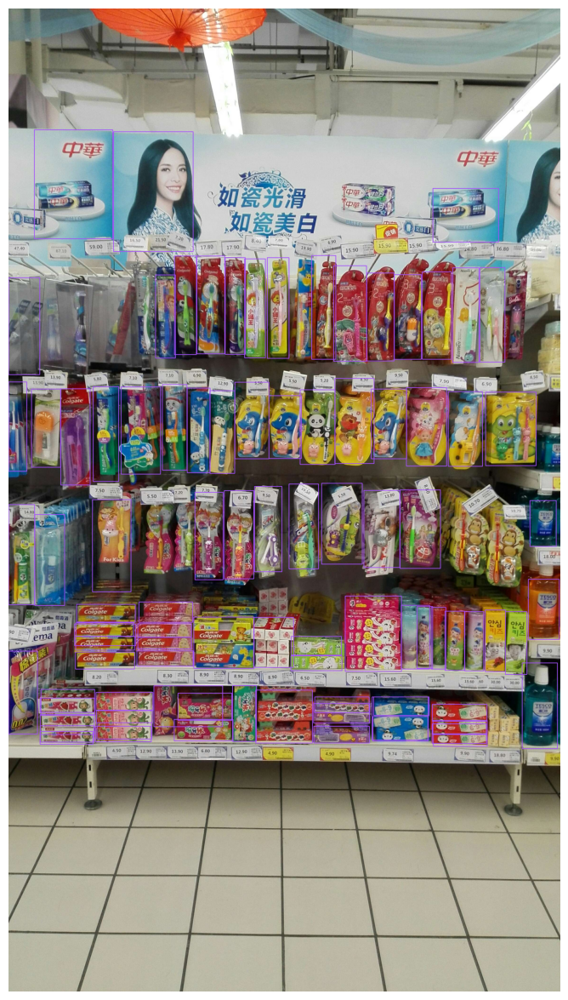

[2023-10-26 05:02:15] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


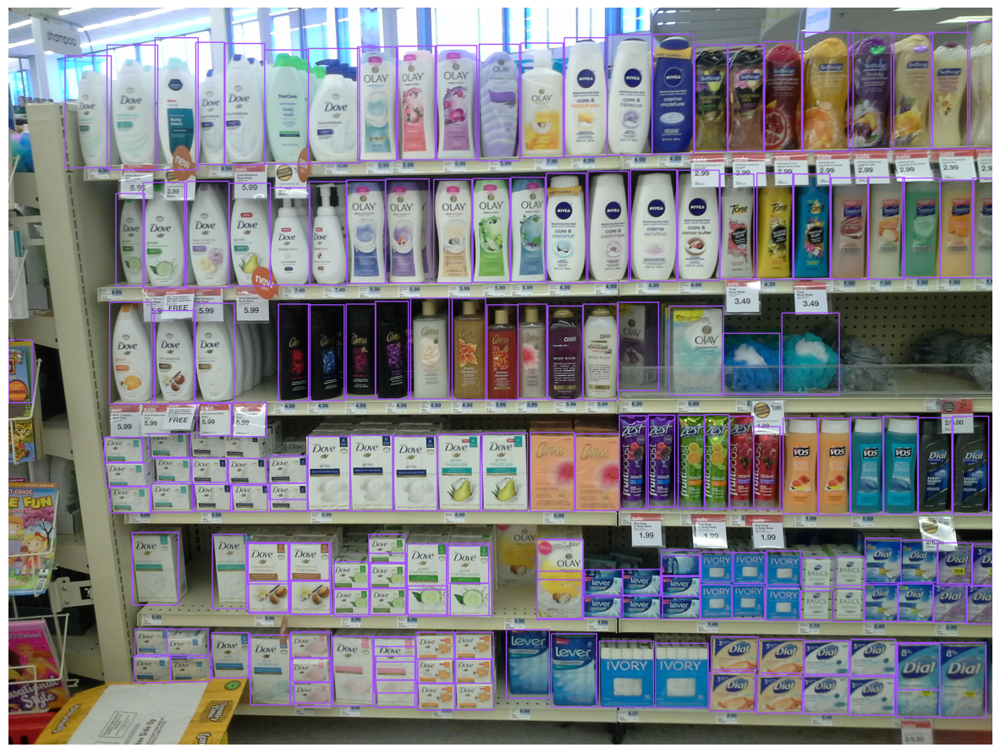

[2023-10-26 05:02:20] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


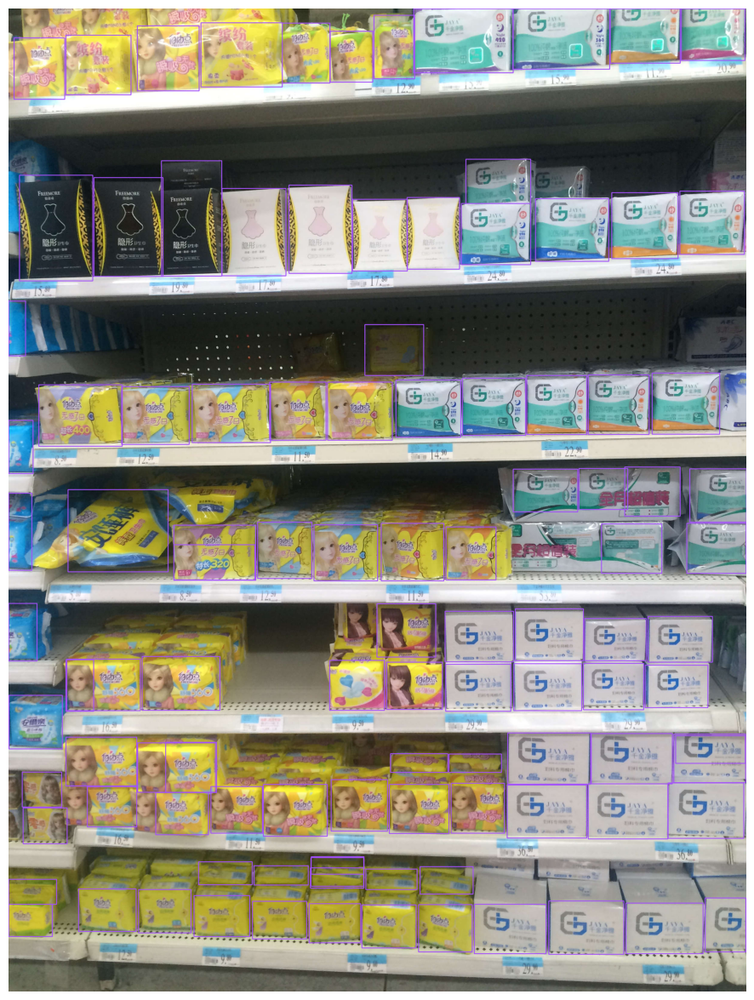

[2023-10-26 05:02:24] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


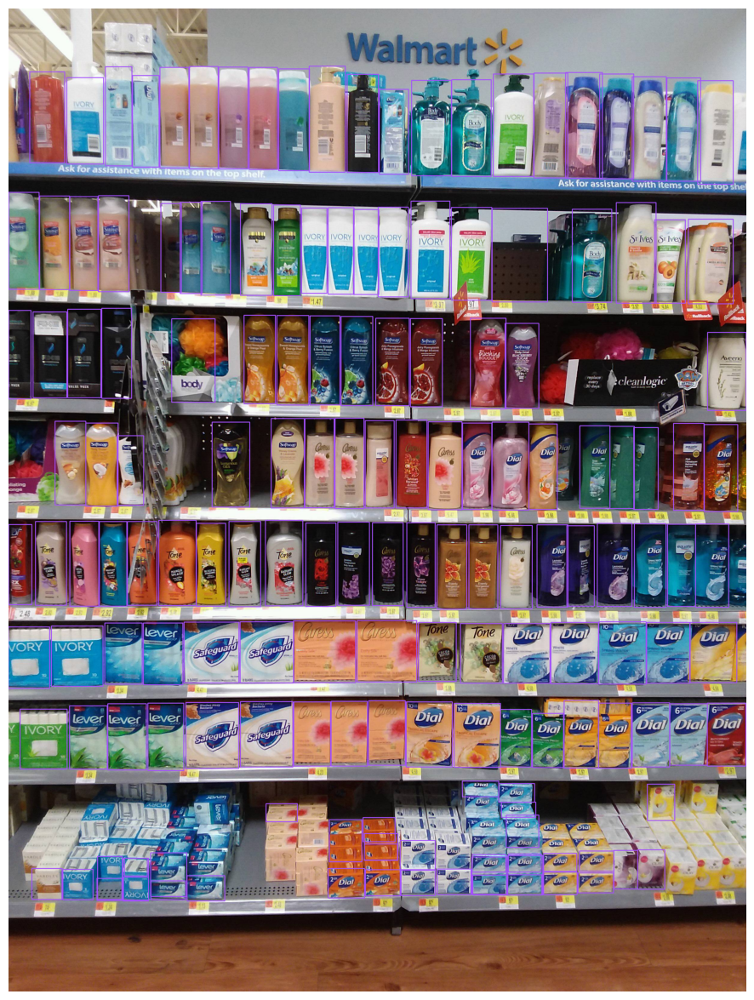

[2023-10-26 05:02:28] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


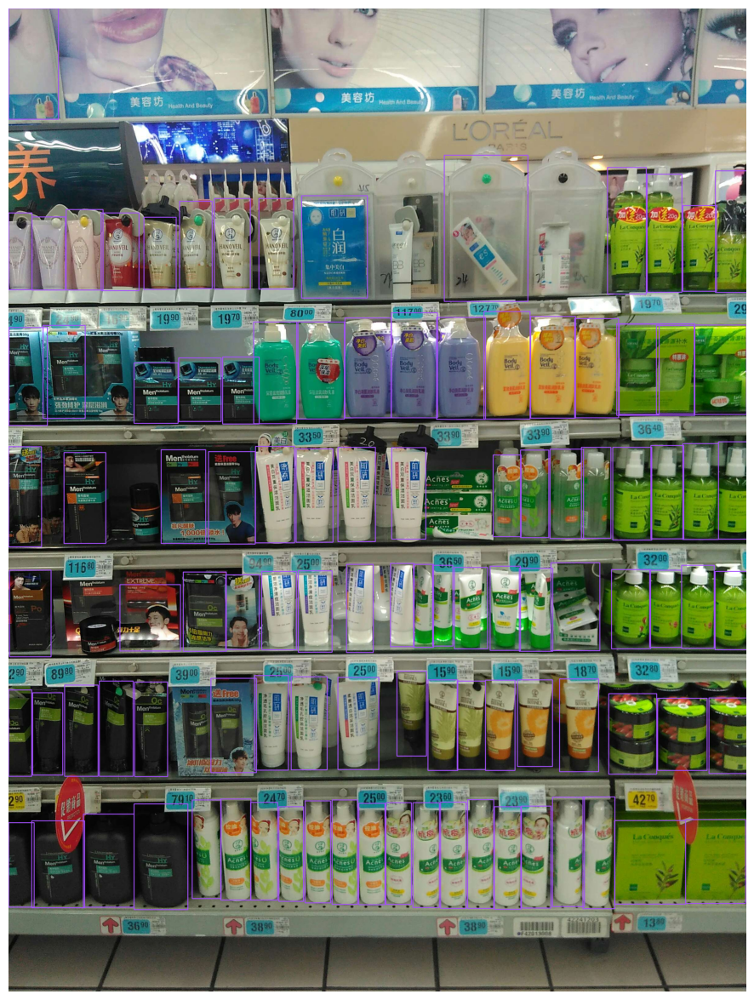

[2023-10-26 05:02:32] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


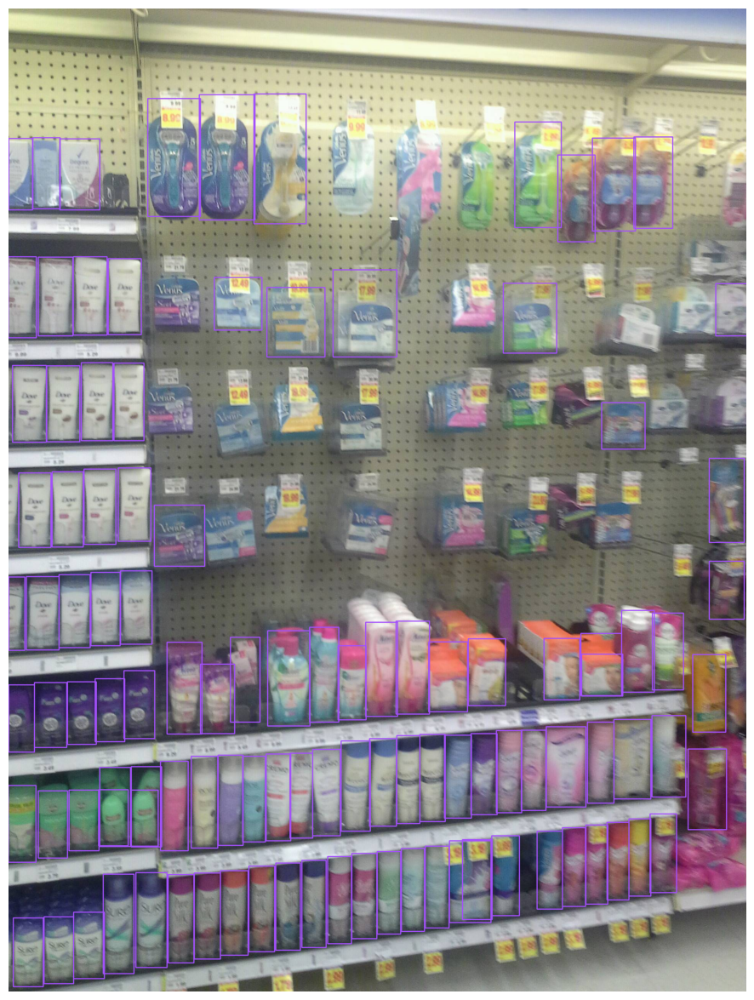

[2023-10-26 05:02:37] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


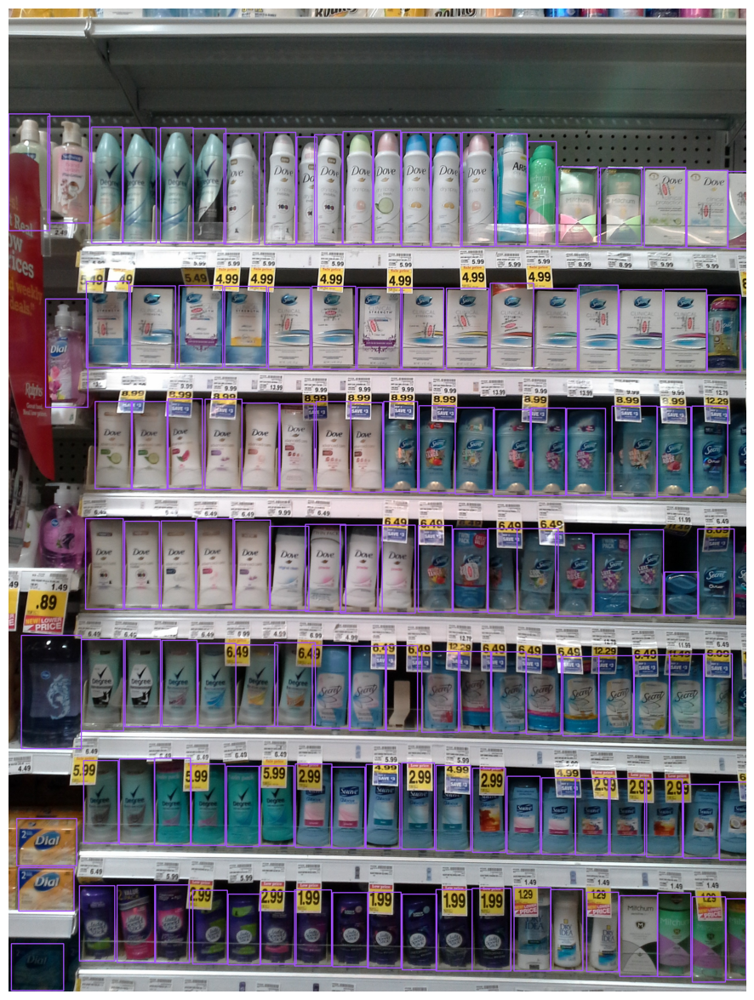

[2023-10-26 05:02:42] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


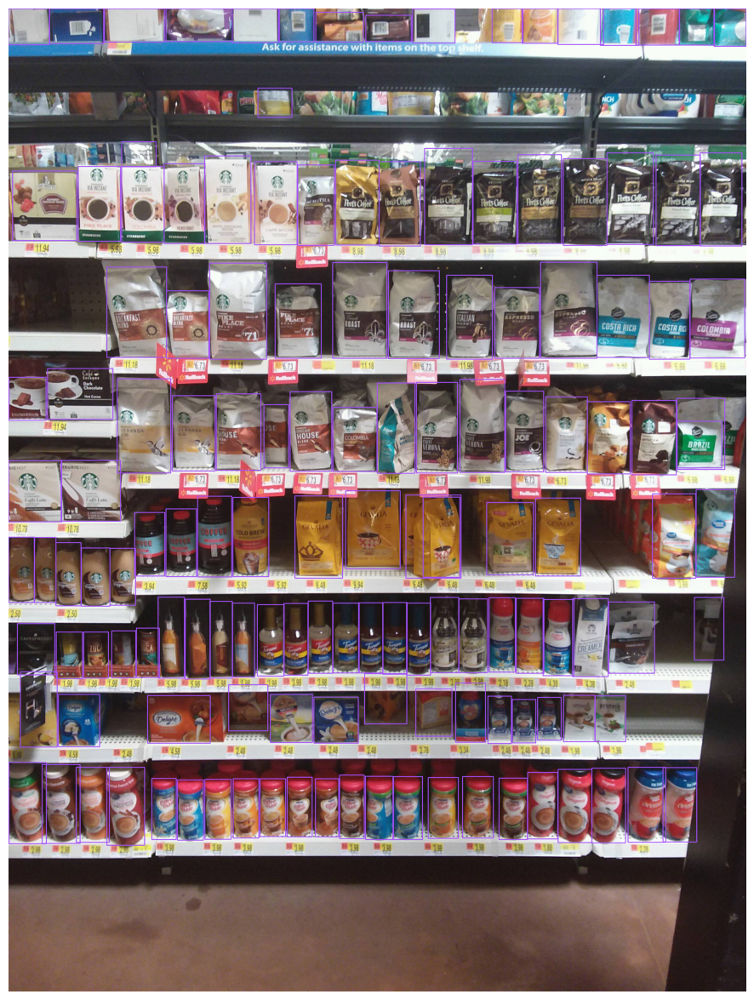

[2023-10-26 05:02:47] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


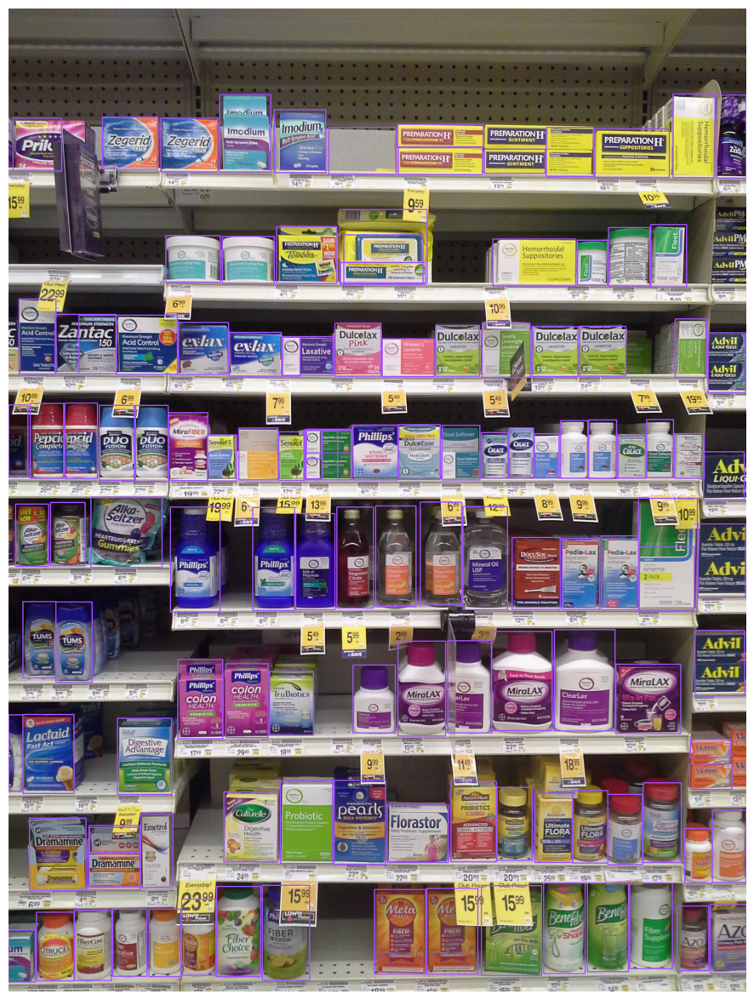

[2023-10-26 05:02:51] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


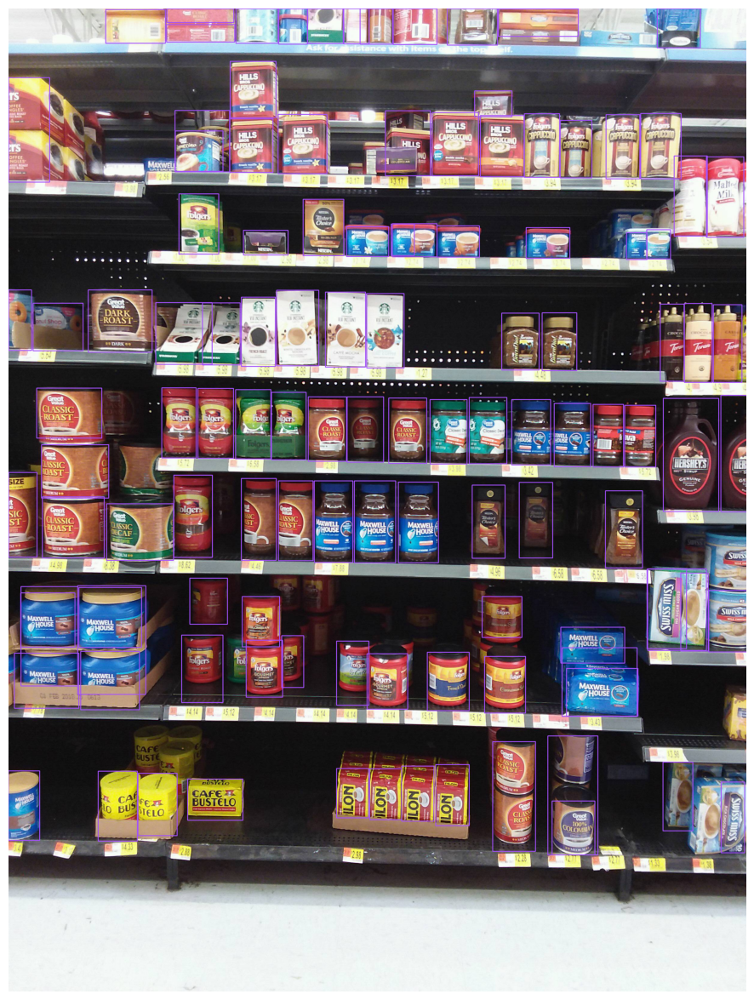

In [8]:
for i in range(10):
  image = cv2.imread(np.random.choice(images))
  result = list(best_model.predict(image, conf=0.5))[0]

  detections = sv.Detections(
      xyxy=result.prediction.bboxes_xyxy,
      confidence=result.prediction.confidence,
      class_id=result.prediction.labels.astype(int)
  )

  box_annotator = sv.BoxAnnotator()
  annotated_frame = box_annotator.annotate(
      scene=image.copy(),
      detections=detections,
      skip_label=True
  )

  %matplotlib inline
  sv.plot_image(annotated_frame, (15, 15))